# Case Study in Natural Science: Detecting Tropical Systems from Satellite Images
## Brendon Gory
## 12/15/2023

### Load Libraries for Project

In [1]:
# Web scraping
import requests
from bs4 import BeautifulSoup
import json

# Standard Python APIs
from datetime import datetime, timedelta
import pandas as pd
import numpy as np
import time
import os
import shutil
import random as rnd
import glob

# Imaging
from PIL import Image
from io import BytesIO
import matplotlib.pyplot as plt
from matplotlib.image import imread
import cv2

# Tensorflow
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras import models
from tensorflow.keras import optimizers
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import utils
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import preprocess_input, decode_predictions

# Sklearn
from sklearn.model_selection import train_test_split

## Web scraping

### Get all available websites from nhc.noaa.gov from 7/9/2014 to 11/30/2023

In [2]:
%%time

url_bases = {'https://archive.org/wayback/available?url=nhc.noaa.gov/gtwo.php?basin=atlc&fdays=2&timestamp=':'atlc',
            'https://archive.org/wayback/available?url=nhc.noaa.gov/gtwo.php?basin=epac&fdays=2&timestamp=': 'epac'}

df = pd.DataFrame()
locations, urls, json_responses, timestamps, outlook_texts = [], [], [], [], []

for url_base, loc in url_bases.items():
    start_date = datetime.strptime('20140709', '%Y%m%d')
    end_date = datetime.strptime('20231130', '%Y%m%d')

    curr_date = start_date

    while curr_date <= end_date:
        date_str = curr_date.strftime('%Y%m%d')
        curr_date += timedelta(days=1)
        url = f'{url_base}{date_str}'

        # Send a GET request to the URL
        response_for_image = requests.get(url)

        # Check if the request was successful (status code 200)
        if response_for_image.status_code == 200:
            json_string = response_for_image.text.replace("'", "\"")
            json_data = json.loads(json_string)
            snapshot_data = json_data['archived_snapshots']
            
            if len(snapshot_data) > 0:
                url_value = snapshot_data['closest']['url']
                
                if not url_value in urls:
                    # Ensure snapshot is unique
                    
                    # Parse the HTML content with BeautifulSoup
                    try:
                        response_for_text = requests.get(url_value)
                        soup = BeautifulSoup(response_for_text.text, 'html.parser')
                        pre_tag = soup.find('pre')
                        if pre_tag:
                            # Find the specific text based on the HTML structure
                            outlook_texts.append(soup.find('pre').get_text().replace('\n','|'))                        
                            locations.append(loc)
                            json_responses.append(json_data)
                            urls.append(url_value)
                            timestamps.append(snapshot_data['closest']['timestamp'])
                            
                            if len(timestamps) % 100 == 0:
                                print(f'Processing {loc}: {len(timestamps)} total records')
                                      
                    except requests.exceptions.RequestException as e:
                        pass
        else:
            # If the request was not successful, print an error message
            print(f"Error: Unable to fetch data. Status code: {response.status_code}\n{data_str}")

df['location'] = locations
df['JSON'] = json_responses
df['URL'] = urls
df['timestamp'] = timestamps
df['outlook_text'] = outlook_texts
df.to_csv('../data/available_urls.csv', index=False)


# df = pd.read_csv('../data/available_urls.csv')
# for idx, row in df.iterrows():
#     if idx % 100 == 0 and idx > 0:
#         print(f"Processing {row['location']}: {idx} total records")
# timestamps = df['timestamp']
print(f'Days checked {len(timestamps)}')

Processing atlc: 100 total records
Processing atlc: 200 total records
Processing atlc: 300 total records
Processing epac: 400 total records
Processing epac: 500 total records
Days checked 526
CPU times: total: 0 ns
Wall time: 38 ms


### Save image and label based on forecast discussion

In [3]:
%%time

def contains_literal(text, literals):
    for literal in literals:
        if literal in text:
            return True
    return False

df = pd.read_csv('../data/available_urls.csv')

### Literals for text below images with no supposed storms
no_storms = []
# Pattern 1
no_storms.append('Tropical cyclone formation is not expected during the next 5 days.')
no_storms.append('Tropical cyclone formation is not expected during the next 7 days.')

# Pattern 2
no_storms.append('During the off-season, Special Tropical Weather|Outlooks will be issued as conditions warrant.')
no_storms.append('During the|off-season, Special Tropical Weather Outlooks will be issued as|conditions warrant.')
no_storms.append('During the off-season, Special Tropical Weather Outlooks will be|issued as conditions warrant.')
no_storms.append('During the off-season, Special Tropical Weather Outlooks|will be issued as conditions warrant.')

# Pattern 3
no_storms.append('while Special Tropical Weather Outlooks will |be issued as necessary during the off-season.')
no_storms.append('while Special Tropical Weather Outlooks |will be issued as necessary during the off-season.')

for idx, row in df.iterrows():
    loc = 'pac'
    if row['location'] == 'atlc': loc = 'atl'
    timestamp = row['timestamp']
    outlook_text = row['outlook_text']
    
    if contains_literal(outlook_text, no_storms):
        # No active storms label
        label = 0
    else:
        # Active storms label
        label = 1
            
    image_filename = f'data/{loc}/{timestamp}_{label}.png'
    if not os.path.isfile(image_filename):
        image_url = f'https://web.archive.org/web/{timestamp}im_/http://www.nhc.noaa.gov/xgtwo/two_{loc}_2d0.png'
        response = requests.get(image_url)
        time.sleep(5)
        img = Image.open(BytesIO(response.content))
        time.sleep(5)
        img.save(image_filename)

CPU times: total: 15.6 ms
Wall time: 42.8 ms


### Correct labels based on images
Iterative process of looking at the images and determining if there is any stage of storm in the satellite image. Storms may appear in the image, but outside of the forecast discussion area.

#### Correct the labels (images do not match forecast discussion)

In [4]:
no_storms = [
    '20150507175314', '20160527001038', '20160608234541', '20160625002014',
    '20160727215547', '20180513055037', '20180722053531', '20180520190740',
    '20180722053531', '20191116142939', '20191116142939', '20210609014948',
    '20220523000143', '20220529000133', '20230524201813', 
    
    '20170627040459', '20170629011337', '20170921231236', '20170930220756', 
    '20181128040339', '20191104202742', '20200526010308', '20200621031149',
    '20201101080950', '20201102081935', '20201103082850', '20210911090701', 
    '20220605070204'
]

for loc in ['atl', 'pac']:
    for file in no_storms:
        image_filename = f'../data/{loc}/{file}_1.png'
        if os.path.isfile(image_filename):
            os.rename(image_filename, f'../data/{loc}/{file}_0.png')
            
storms = [
    '20151109205508', '20160529045756', '20160921222422', '20160921222422',
    '20161010030410', '20161011105656', '20161014005246', '20161024045040',
    '20161026083221', '20160114161911', '20170923050509', '20171009195206',
    '20180527052238', '20180626055040', '20180701052209', '20181028054501',
    '20190505034021', '20191019221318', '20200517124008', '20200605005105',
    '20200719032040', '20201027013155', '20201028092404', '20201101005918',
    '20201103080626', '20201105080847', '20201106174549', '20201202070603',
    '20201218030822', '20210116070016', '20210121123940', '20210318073325',
    '20210319122156', '20210818153911', '20210818154101', '20220524000156',
    '20220605070204', '20220929055841', '20220929120212', '20221010000329',
    '20221208180543', '20230116153610', '20230116161134', '20230908175020',
    
    '20150816220312', '20170728174741', '20170831233412', '20170904072048',
    '20170906055738', '20171101083057', '20180615162907', '20180617070335',
    '20180701063301', '20181021061721', '20190502140325', '20190502191853',
    '20190602033001', '20190608203117', '20190609030948', '20190614165103',
    '20190616031331', '20190714032308', '20191108004739', '20191110025405',
    '20191117033205', '20191128193031', '20191201143336', '20200426065405',
    '20200531031728', '20200726070946', '20200802030302', '20200817040704',
    '20200906031649', '20201107082301', '20201108082810', '20211112150211',
    '20211127210559', '20211130004200', '20220117021203', '20220529050726',
    '20220619203555', '20220705081700', '20220922000151', '20220922014914'
]     

for loc in ['atl', 'pac']:
    for file in storms:
        image_filename = f'../data/{loc}/{file}_0.png'
        if os.path.isfile(image_filename):
            os.rename(image_filename, f'../data/{loc}/{file}_1.png')

### View images and their labels

Random Images for atl


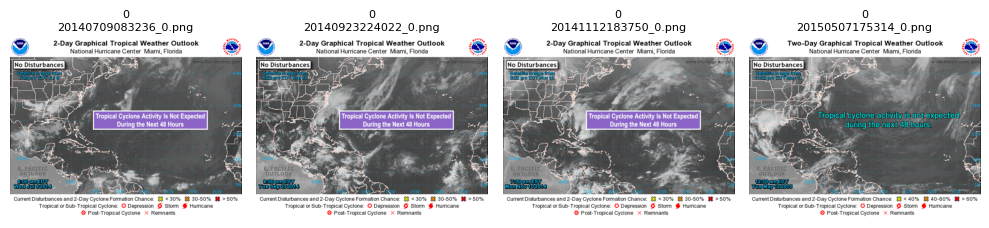

['20140709083236_0.png', '20140923224022_0.png', '20141112183750_0.png', '20150507175314_0.png']


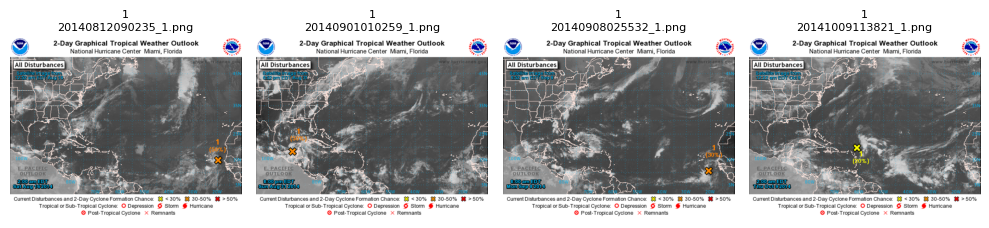

['20140812090235_1.png', '20140901010259_1.png', '20140908025532_1.png', '20141009113821_1.png']
Random Images for pac


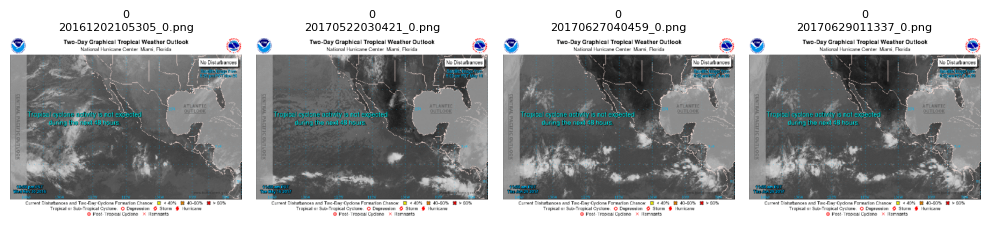

['20161202105305_0.png', '20170522030421_0.png', '20170627040459_0.png', '20170629011337_0.png']


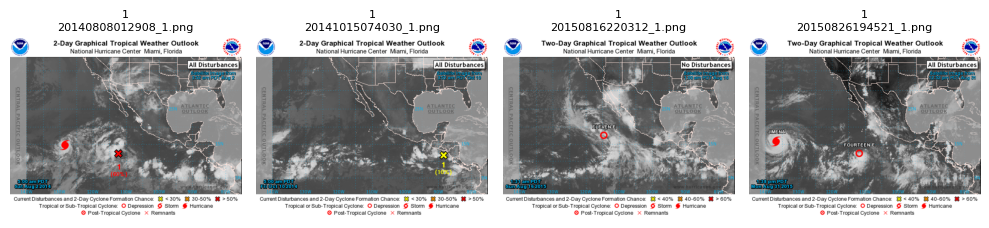

['20140808012908_1.png', '20141015074030_1.png', '20150816220312_1.png', '20150826194521_1.png']


In [5]:
def display_images_in_directory(directory_path, png_files):
    fig, axes = plt.subplots(1, 4, figsize=(10, 8))
    axes = axes.flatten()

    # Iterate over the images and plot them on subplots
    for i, png_file in enumerate(png_files):
        image_path = os.path.join(directory_path, png_file)

        # Open the image and resize it (adjust the size as needed)
        img = Image.open(image_path)
        img = img.resize((image_width, image_height))

        # Plot the image on the corresponding subplot
        axes[i].imshow(img)
        axes[i].axis('off')  # Turn off axis labels

        # Set a title (optional)
        label = png_file.split('_')[1].replace('.png', '')
        axes[i].set_title(f'{label}\n{png_file}', fontsize=8)
            
        
    if i < 3:
        for j in range(i + 1, 4):
            fig.delaxes(axes[j])
            
    # Adjust layout to prevent overlapping titles
    plt.tight_layout()
    
    # Show the plot
    plt.show()
    
    print(png_files)

image_height = 390
image_width = 500

random_images = {}
rnd.seed(31415)
for loc in ['atl', 'pac']:
    print(f'Random Images for {loc}')
    directory_path = f'../data/{loc}'
    for label in ['0', '1']:
        png_files = [file for file in os.listdir(directory_path) if file.endswith(f'{label}.png')]
        random_files = rnd.sample(png_files, 4)
        random_images[f'{loc}:{label}'] = random_files
        for i in range(0, len(random_files), 4):
            display_images_in_directory(directory_path, png_files[i: i + 4])

## Load images

### Create directories for train, validation and test

In [6]:
# Create train/validation/test directories
images_dir = os.path.join('../data', 'images')
if os.path.exists(images_dir): shutil.rmtree(images_dir)
os.mkdir(images_dir)

train_dir = os.path.join(images_dir, 'train')
if os.path.exists(train_dir): shutil.rmtree(train_dir)
os.mkdir(train_dir)

val_dir = os.path.join(images_dir, 'val')
if os.path.exists(val_dir): shutil.rmtree(val_dir)
os.mkdir(val_dir)

test_dir = os.path.join(images_dir, 'test')
if os.path.exists(test_dir): shutil.rmtree(test_dir)
os.mkdir(test_dir)

all_storms_dir = os.path.join('../data', 'all_storms')
if os.path.exists(all_storms_dir): shutil.rmtree(all_storms_dir)
os.mkdir(all_storms_dir)

# Move all images for atl and pac to one folder
calm_cnt = 0
storm_cnt = 0
for loc in ['atl', 'pac']:
    target_dir = os.path.join('../data', loc)
    for file in os.listdir(target_dir):
        source_file = os.path.join(target_dir, file)
        label = file.split('_')[1].replace('.png', '')
        if label == '0':
            prefix = 'calm'
            calm_cnt += 1
            dest_file = os.path.join(all_storms_dir, f'{prefix}.{calm_cnt}.png')
        else:
            prefix = 'storm'
            storm_cnt += 1
            dest_file =  os.path.join(all_storms_dir, f'{prefix}.{storm_cnt}.png')
        
        shutil.copyfile(source_file, dest_file)


# Train calm directory
train_calm_dir = os.path.join(train_dir, 'calm')
os.mkdir(train_calm_dir)

# Train calm directory
train_storm_dir = os.path.join(train_dir, 'storm')
os.mkdir(train_storm_dir)

# Val calm directory
val_calm_dir = os.path.join(val_dir, 'calm')
os.mkdir(val_calm_dir)

# Val storm directory
val_storm_dir = os.path.join(val_dir, 'storm')
os.mkdir(val_storm_dir)

# Test calm directory
test_calm_dir = os.path.join(test_dir, 'calm')
os.mkdir(test_calm_dir)

# Test storm directory
test_storm_dir = os.path.join(test_dir, 'storm')
os.mkdir(test_storm_dir)

### Create train/val/test split

In [7]:
def create_splits(all_files, desc):
    train_files, temp_files = train_test_split(all_files, test_size=0.4, random_state=31415)
    val_files, test_files = train_test_split(temp_files, test_size=0.25, random_state=31415)

    dest_dir = os.path.join(train_dir, desc)
    for src_file in train_files:
        dest_file = os.path.join(dest_dir, os.path.basename(src_file))
        shutil.copyfile(src_file, dest_file)
        
    dest_dir = os.path.join(val_dir, desc)        
    for src_file in val_files:
        dest_file = os.path.join(dest_dir, os.path.basename(src_file))
        shutil.copyfile(src_file, dest_file)     
    
    dest_dir = os.path.join(test_dir, desc)
    for src_file in test_files:
        dest_file = os.path.join(dest_dir, os.path.basename(src_file))
        shutil.copyfile(src_file, dest_file)
        
    print(f'{desc}:')
    print(f'\tTotal Images: {len(all_files)}')
    print(f'\tTrain Size: {len(train_files)}')
    print(f'\tValidation Size: {len(val_files)}')
    print(f'\tTest Size: {len(test_files)}')


create_splits(glob.glob(os.path.join(all_storms_dir, 'calm*.png')), 'Calm')
create_splits(glob.glob(os.path.join(all_storms_dir, 'storm*.png')), 'Storm')

Calm:
	Total Images: 252
	Train Size: 151
	Validation Size: 75
	Test Size: 26
Storm:
	Total Images: 274
	Train Size: 164
	Validation Size: 82
	Test Size: 28


## Build and fit CNN model

In [8]:
def get_model():
    tf.keras.backend.clear_session()

    model = models.Sequential(name='Base_Model')
    model.add(layers.Conv2D(32, (3, 3), activation='relu',
                            input_shape=(image_height, image_width, 3)))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(64, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(128, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Conv2D(128, (3, 3), activation='relu'))
    model.add(layers.MaxPooling2D((2, 2)))
    model.add(layers.Flatten())
    model.add(layers.Dense(512, activation='relu'))
    model.add(layers.Dense(1, activation='sigmoid'))

    model.compile(loss='binary_crossentropy',
                  optimizer=optimizers.RMSprop(learning_rate=1e-4),
                  metrics=['acc'])

    model.summary()
    
    return model

model = get_model()

Model: "Base_Model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 388, 498, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 194, 249, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 192, 247, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 96, 123, 64)      0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 94, 121, 128)      73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 47, 60, 128)      0

### Preprocess images

In [9]:
def datagen_load_images():
    train_datagen = ImageDataGenerator(rescale=1./255)
    val_datagen = ImageDataGenerator(rescale=1./255)

    train_generator = train_datagen.flow_from_directory(
            train_dir, target_size=(image_width, image_height),
            batch_size=20, class_mode='binary')

    validation_generator = val_datagen.flow_from_directory(
            val_dir, target_size=(image_width, image_height),
            batch_size=20, class_mode='binary')

    for data_batch, labels_batch in train_generator:
        print('data batch shape:', data_batch.shape)
        print('labels batch shape:', labels_batch.shape)
        break
        
    return train_generator, validation_generator

train_generator, validation_generator = datagen_load_images()

Found 315 images belonging to 2 classes.
Found 157 images belonging to 2 classes.
data batch shape: (20, 500, 390, 3)
labels batch shape: (20,)


### Fit model

In [10]:
%%time
def fit_model(model, train_generator, validation_generator):
    history = model.fit(
        train_generator,
        steps_per_epoch=len(train_generator),
        epochs=10,
        validation_data=validation_generator,
        validation_steps=len(validation_generator),
        verbose=1)
    
    return history

history = fit_model(model, train_generator, validation_generator)

Epoch 1/10
16/16 [==============================] - 12s 435ms/step - loss: 0.6767 - acc: 0.5968 - val_loss: 0.4893 - val_acc: 0.8535
Epoch 2/10
16/16 [==============================] - 3s 208ms/step - loss: 0.2806 - acc: 0.9302 - val_loss: 0.1112 - val_acc: 0.9936
Epoch 3/10
16/16 [==============================] - 3s 208ms/step - loss: 0.0759 - acc: 0.9841 - val_loss: 0.0633 - val_acc: 0.9936
Epoch 4/10
16/16 [==============================] - 3s 211ms/step - loss: 0.0424 - acc: 0.9905 - val_loss: 0.0140 - val_acc: 0.9936
Epoch 5/10
16/16 [==============================] - 3s 206ms/step - loss: 0.0401 - acc: 0.9873 - val_loss: 0.0162 - val_acc: 0.9936
Epoch 6/10
16/16 [==============================] - 3s 210ms/step - loss: 0.0255 - acc: 0.9937 - val_loss: 0.0120 - val_acc: 0.9936
Epoch 7/10
16/16 [==============================] - 3s 207ms/step - loss: 0.0371 - acc: 0.9937 - val_loss: 0.0107 - val_acc: 0.9936
Epoch 8/10
16/16 [==============================] - 3s 209ms/step - loss: 0

### Plot history

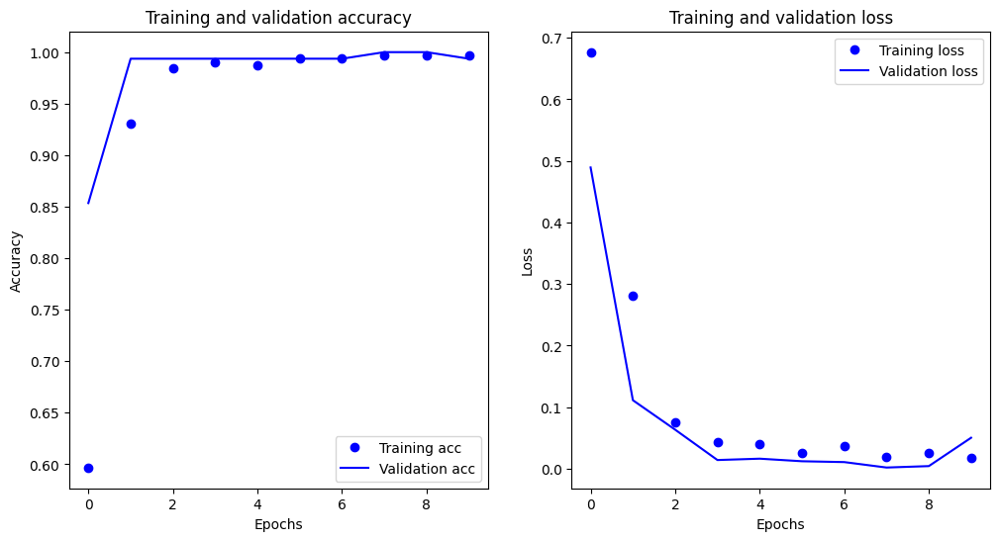

In [11]:
def plot_history(history):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes = axes.flatten()
    acc = history.history['acc']
    val_acc = history.history['val_acc']

    epochs = range(len(acc))

    axes[0].plot(epochs, acc, 'bo', label='Training acc')
    axes[0].plot(epochs, val_acc, 'b', label='Validation acc')
    axes[0].set_ylabel('Accuracy')
    axes[0].set_xlabel('Epochs')
    axes[0].set_title('Training and validation accuracy')
    axes[0].legend()

    loss = history.history['loss']
    val_loss = history.history['val_loss']
    axes[1].plot(epochs, loss, 'bo', label='Training loss')
    axes[1].plot(epochs, val_loss, 'b', label='Validation loss')
    axes[1].set_ylabel('Loss')
    axes[1].set_xlabel('Epochs')
    axes[1].set_title('Training and validation loss')
    axes[1].legend()

    plt.show()
    
plot_history(history)    

## Predict

In [12]:
def display_images_in_tensor(png_files, predictions, pred_labels, actual_label):
    fig, axes = plt.subplots(1, 4, figsize=(10, 8))
    axes = axes.flatten()

    # Iterate over the images and plot them on subplots
    for idx, png_file in enumerate(png_files):
        img = Image.open(png_file)
        img = img.resize((image_width, image_height))

        # Plot the image on the corresponding subplot
        axes[idx].imshow(img)
        axes[idx].axis('off')  # Turn off axis labels

        # Set a title (optional)
        title = f'Predicted Label: {pred_labels[idx]}'
        title += f' -- Actual Label: {actual_label}'
        title += f'\n(confidence: {predictions[idx]})'
        title += f'\n{os.path.basename(png_file)}'
        axes[idx].set_title(title, fontsize=8)
            
    if idx < 3:
        for j in range(idx + 1, 4):
            fig.delaxes(axes[j])
            
    # Adjust layout to prevent overlapping titles
    plt.tight_layout()
    
    # Show the plot
    plt.show()

    
def convert_to_tensor_and_predict(model, target_dir, label):
    group_count = 0
    png_files, predictions, pred_labels  = [], [], []
    correct, image_count = 0, 0
    
    for test_image in glob.glob(f'{target_dir}/*.png'):
        img = cv2.imread(test_image)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # Convert color to RGB space instead of default BGR space

        # Resize image
        resized_img = cv2.resize(img_rgb, (image_width, image_height)) 
        dimensions = resized_img.shape 
        height = resized_img.shape[0]   # Height is at index 0  
        width = resized_img.shape[1]    # Width is at index 1   
        channels = resized_img.shape[2] # no. of channels is at index 2

        # Set tensor size
        img_tensor = utils.img_to_array(resized_img)
        img_tensor = np.expand_dims(img_tensor, axis=0)
        img_tensor /= 255.

        # Get prediction
        prediction = model.predict(img_tensor)[0][0]
        prediction = round(prediction, 2)
        if prediction < .5:
            pred_label = '0'
        else:
            pred_label = '1'
            
        pred_labels.append(pred_label)
        predictions.append(str(prediction))
        png_files.append(test_image)
        
        group_count += 1
        if group_count > 3:
            display_images_in_tensor(png_files, predictions, pred_labels, label)
            predictions, png_files = [], []
            group_count = 0
    
        image_count += 1
        if pred_label == label:
            correct += 1
            
    # Display remaining predictions        
    if len(predictions) > 0:
        display_images_in_tensor(png_files, predictions, pred_labels, label)
        
    return round(correct/image_count, 2) * 100

### Predictions of `calm` images

1/1 [==============================] - 0s 15ms/step


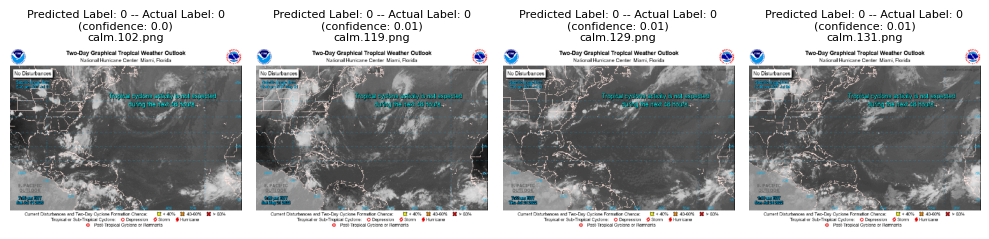

1/1 [==============================] - 0s 16ms/step


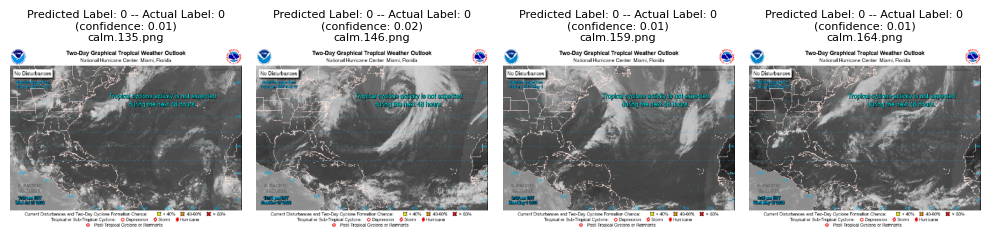

1/1 [==============================] - 0s 16ms/step


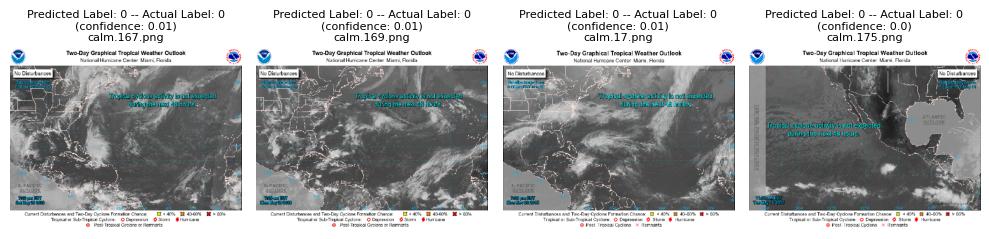

1/1 [==============================] - 0s 16ms/step


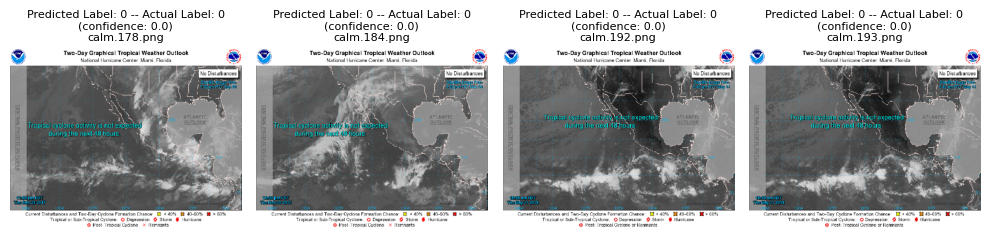

1/1 [==============================] - 0s 16ms/step


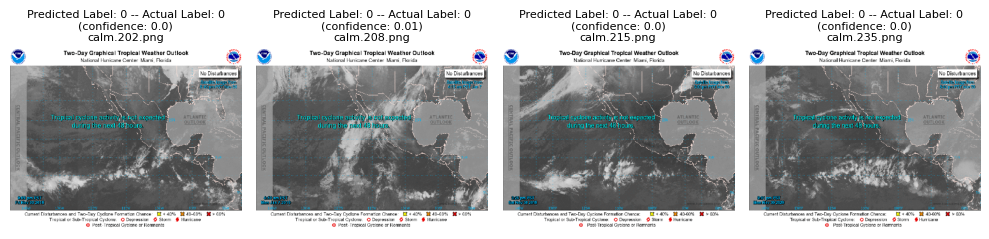

1/1 [==============================] - 0s 16ms/step


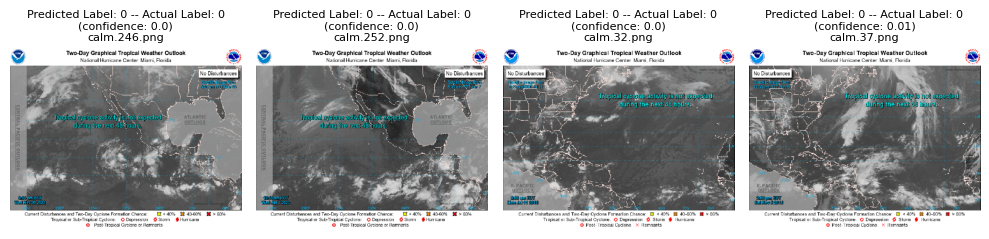

1/1 [==============================] - 0s 6ms/step


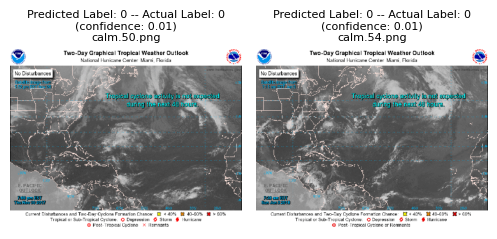

Accuracy: 100.0%


In [13]:
accuracy = convert_to_tensor_and_predict(model, test_calm_dir, '0')
print(f'Accuracy: {accuracy}%')

### Predictions of `storm` images

1/1 [==============================] - 0s 16ms/step


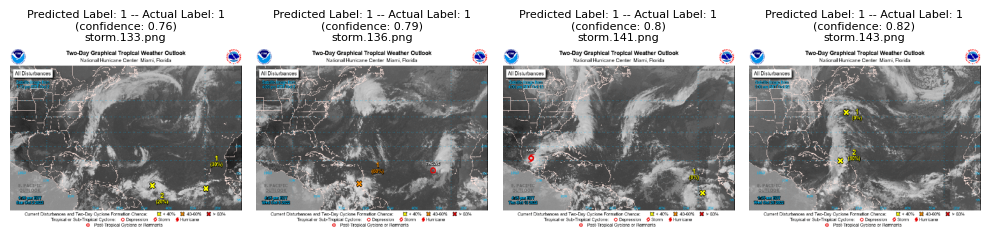

1/1 [==============================] - 0s 16ms/step


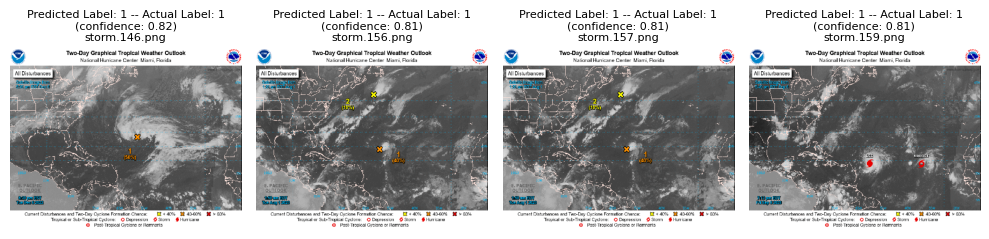

1/1 [==============================] - 0s 16ms/step


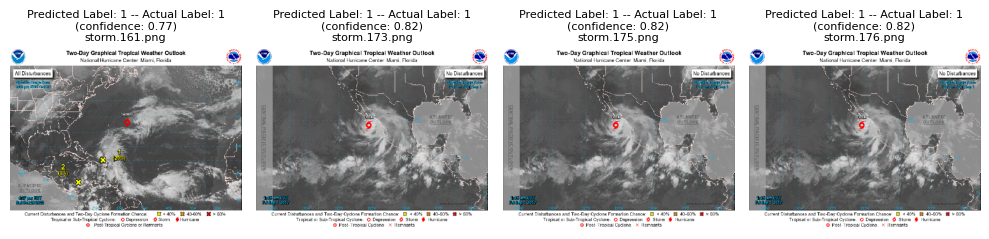

1/1 [==============================] - 0s 16ms/step


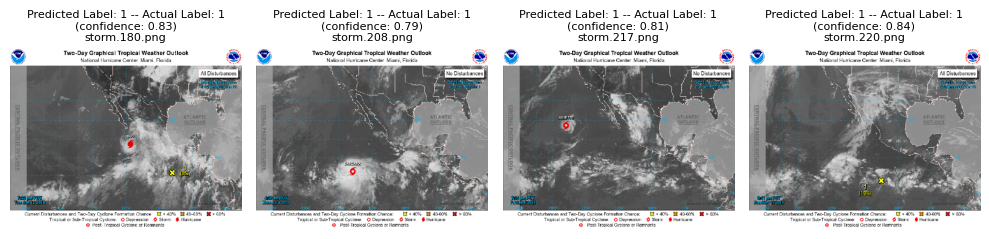

1/1 [==============================] - 0s 16ms/step


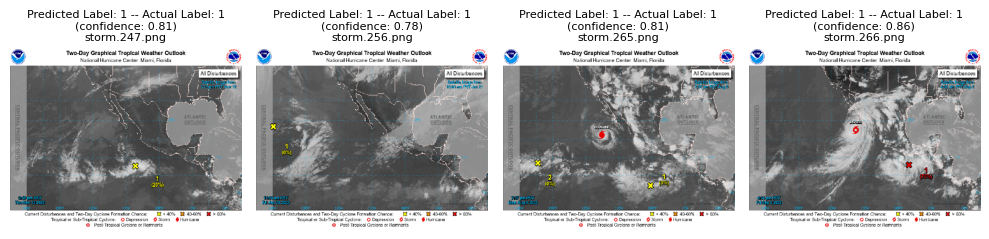

1/1 [==============================] - 0s 16ms/step


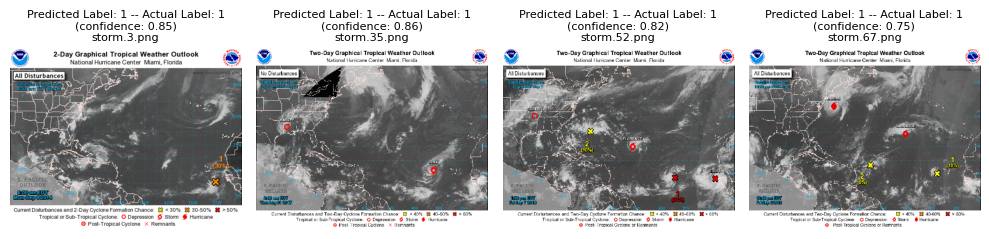

1/1 [==============================] - 0s 20ms/step


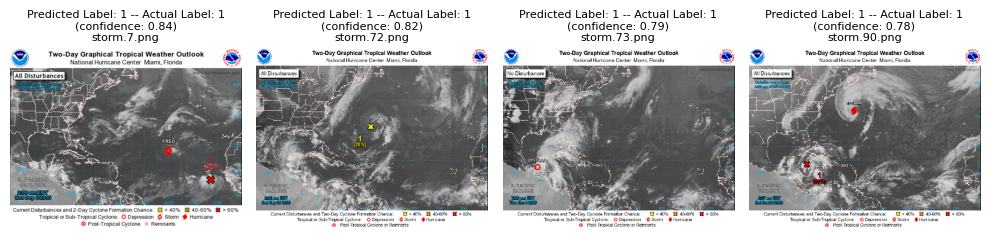

Accuracy: 100.0%


In [14]:
convert_to_tensor_and_predict(model, test_storm_dir, '1')
print(f'Accuracy: {accuracy}%')

## Determine focus of CNN model

### Laplacian edge detection

In [15]:
def laplacian(image_file, image_type):
    # Load the image in grayscale
    img = cv2.imread(image_file)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (image_width, image_height))
    cur_image_width = img.shape[0]
    cur_image_height = img.shape[1]

    # Define Laplacian filter
    filter_matrix_1 = np.stack((np.array([0, 1, 0]), np.array([1, -4, 1]), np.array([0, 1, 0])))
    filter_matrix_2 = np.stack((np.array([-1, -1, -1]), np.array([-1, 8, -1]), np.array([-1, -1, -1])))

    # Instantiate edge matrix
    feature_matrix_1 = np.zeros_like(img)
    feature_matrix_2 = np.zeros_like(img)

    # Move filter over image matrix, stride of 1
    for i in range(cur_image_width - 2): # Move right
        for j in range(cur_image_height - 2): # Move down
            stride_matrix = img[i:i + 3, j:j + 3]
            feature_matrix_1[i + 1, j + 1] = np.sum(np.matmul(stride_matrix, filter_matrix_1))
            feature_matrix_2[i + 1, j + 1] = np.sum(np.matmul(stride_matrix, filter_matrix_2))

            
    # Plot images
    fig, axs = plt.subplots(2, 2, figsize=(12, 10))
    axs = axs.flatten()

    axs[0].imshow(img)
    axs[0].set_title('\nOriginal Image\n\n')
    axs[0].set_yticks([]); axs[0].set_xticks([])
    axs[1].imshow(feature_matrix_1)
    axs[1].set_title(f'Laplacian Filter Applied\n{filter_matrix_1}')
    axs[1].set_yticks([]); axs[1].set_xticks([])
    axs[2].imshow(feature_matrix_2)
    axs[2].set_title(f'\nLaplacian Filter Applied\n{filter_matrix_2}')
    axs[2].set_yticks([]); axs[2].set_xticks([])
    axs[3].imshow(img - feature_matrix_1 - feature_matrix_2)
    axs[3].set_title(f'\n\nLaplacian Filters Removed from Image\n\n')
    axs[3].set_yticks([]); axs[3].set_xticks([])

    plt.suptitle(f'Image Convolutions for {image_type}', y=1, fontsize=24)
    plt.tight_layout()
    plt.show()            

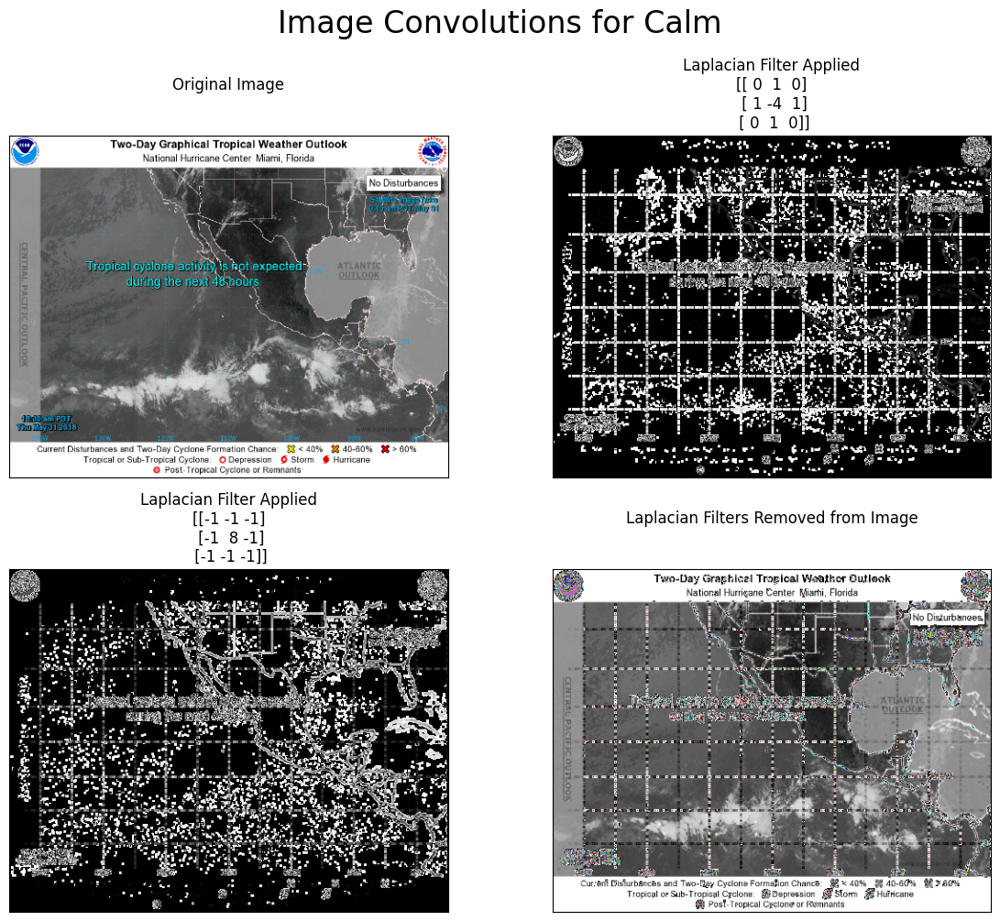

In [16]:
laplacian('../data/images/test/calm/calm.192.png', 'Calm')

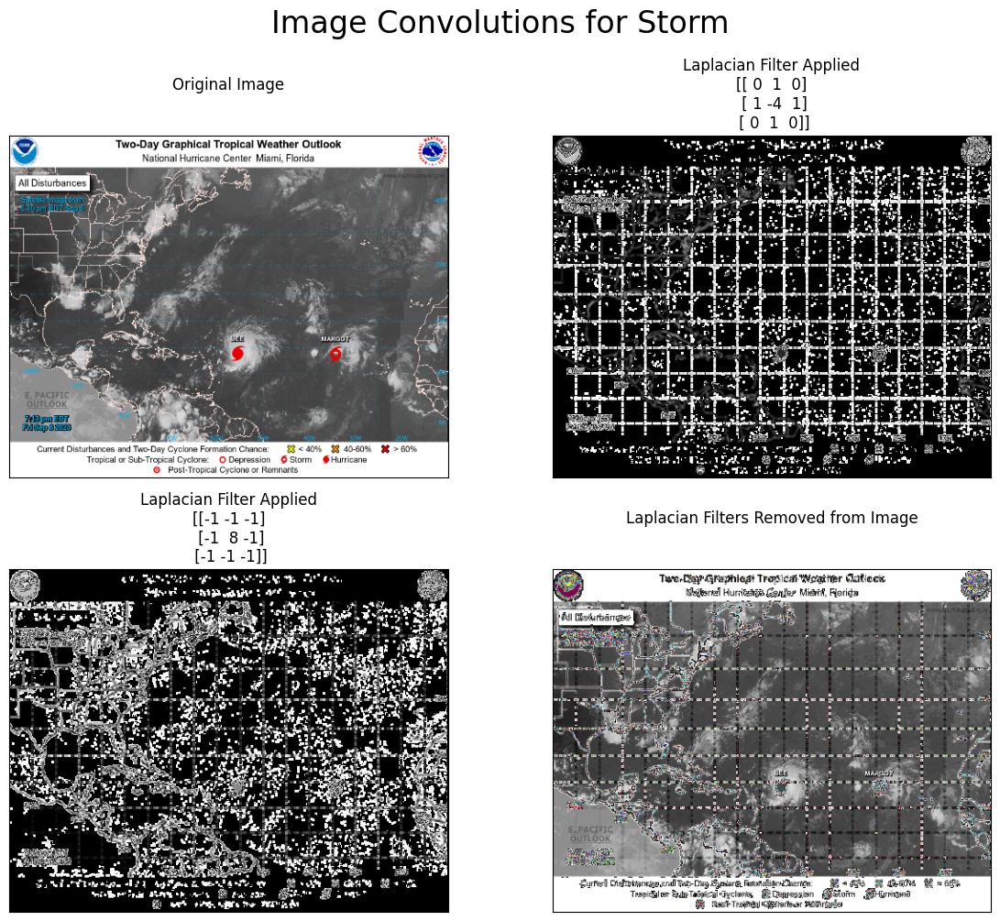

In [17]:
laplacian('../data/images/test/storm/storm.159.png', 'Storm')

### Convolution layer breakdown

In [18]:
model.summary()

feature_extractors = {}
print('\nList of layers:')
for idx, layer in enumerate(model.layers):
    print(f'Layer ({idx+1}) {layer.name}')
    if isinstance(layer, (keras.layers.Conv2D, keras.layers.SeparableConv2D)):
        feature_extractors[layer.name] = keras.Model(inputs=model.input, outputs=layer.output)

Model: "Base_Model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 388, 498, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 194, 249, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 192, 247, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 96, 123, 64)      0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 94, 121, 128)      73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 47, 60, 128)      0

#### Loss function
Djordjević, ZBD, (2023). chapter09_visualizing_VGG16_filters_and_heatmap.ipynb

In [19]:
def compute_loss(image, filter_index, feature_extractor):
    activation = feature_extractor(image)
    """
    Trim the border of the images in case they carry unimportant information
    within the image that the alogorithms do not need
    """
    filter_activation = activation[:, 2:-2, 2:-2, filter_index]
    
    return tf.reduce_mean(filter_activation)

#### Gradient descent
Djordjević, ZBD, (2023). chapter09_visualizing_VGG16_filters_and_heatmap.ipynb

In [20]:
@tf.function
def gradient_ascent_step(image, filter_index, learning_rate, feature_extractor):
    with tf.GradientTape() as tape:
        tape.watch(image)
        # Compute the loss scalar, indicating how much the current image activates the filter.
        loss = compute_loss(image, filter_index, feature_extractor)
    # Compute the gradients of the loss with respect to the image.
    grads = tape.gradient(loss, image)
    # Normilize the gradient by deviding it with its l2 norm
    grads = tf.math.l2_normalize(grads)
    # Move the image a little bit in a direction that activates our target filter more strongly
    image += learning_rate * grads
    # Return the updated image so we can run the step function in a loop.
    return image

#### Layer filter pattern
Djordjević, ZBD, (2023). chapter09_visualizing_VGG16_filters_and_heatmap.ipynb

In [21]:
def generate_filter_pattern(image, feature_extractor, filter_index):
    # number of gradient ascent steps to apply
    iterations = 30
    # Amplitude of a single step
    learning_rate = 10.

    # Resize the image to match the expected input shape
    image = tf.image.resize(image, (390, 500))

    # Repeatedly update the values of the image tensor to maximize our loss function
    for i in range(iterations):
        image = gradient_ascent_step(image, filter_index, learning_rate, feature_extractor)

    return image[0].numpy()

#### Normalize images
Djordjević, ZBD, (2023). chapter09_visualizing_VGG16_filters_and_heatmap.ipynb

In [22]:
def deprocess_image(image):
    image -= image.mean()
    image /= image.std()
    image *= 64
    image += 128
    image = np.clip(image, 0, 255).astype("uint8")
    return image

### Choose random images and show their convolution through the CNN's layers

In [23]:
def plot_random_images(chosen_images, title):
    idx = 0
    fig, axs = plt.subplots(8, 5, figsize=(16, 16))
    axs = axs.flatten()
    
    rnd.seed(31415)
    random_images = rnd.sample(chosen_images, 8)

    for image in random_images:

        # Load random image
        img = cv2.imread(image)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img_rgb = cv2.resize(img_rgb, (image_width, image_height))
        img_tensor = utils.img_to_array(img_rgb)
        img_tensor = np.expand_dims(img_tensor, axis=0)
        img_tensor /= 255.

        axs[idx].imshow(img)
        axs[idx].axis("off")
        axs[idx].set_title(f'{os.path.basename(image)}\nOriginal', fontsize=12)
        idx +=1
        
        # Plot the random image for each convolution layer
        for layer in feature_extractors:
            # Get each filter
            feature_extractor = feature_extractors[layer]
            axs[idx].axis("off")
            axs[idx].imshow(deprocess_image(generate_filter_pattern(img_tensor, feature_extractor, filter_index=8)))
            axs[idx].set_title(f'{os.path.basename(image)}\nlayer({layer})', fontsize=12)
            
            idx +=1

    plt.tight_layout()
    plt.show()

random_calm, random_storms = [], []
for key, val in random_images.items():
    if 'atl' in key:
        image_path = '../data/atl'
    else:
        image_path = '../data/pac'
        
    for image in val:
        if '0' in key:
            random_calm.append(os.path.join(image_path, image))
        else:
            random_storms.append(os.path.join(image_path, image))

### Convolutions for `calm`

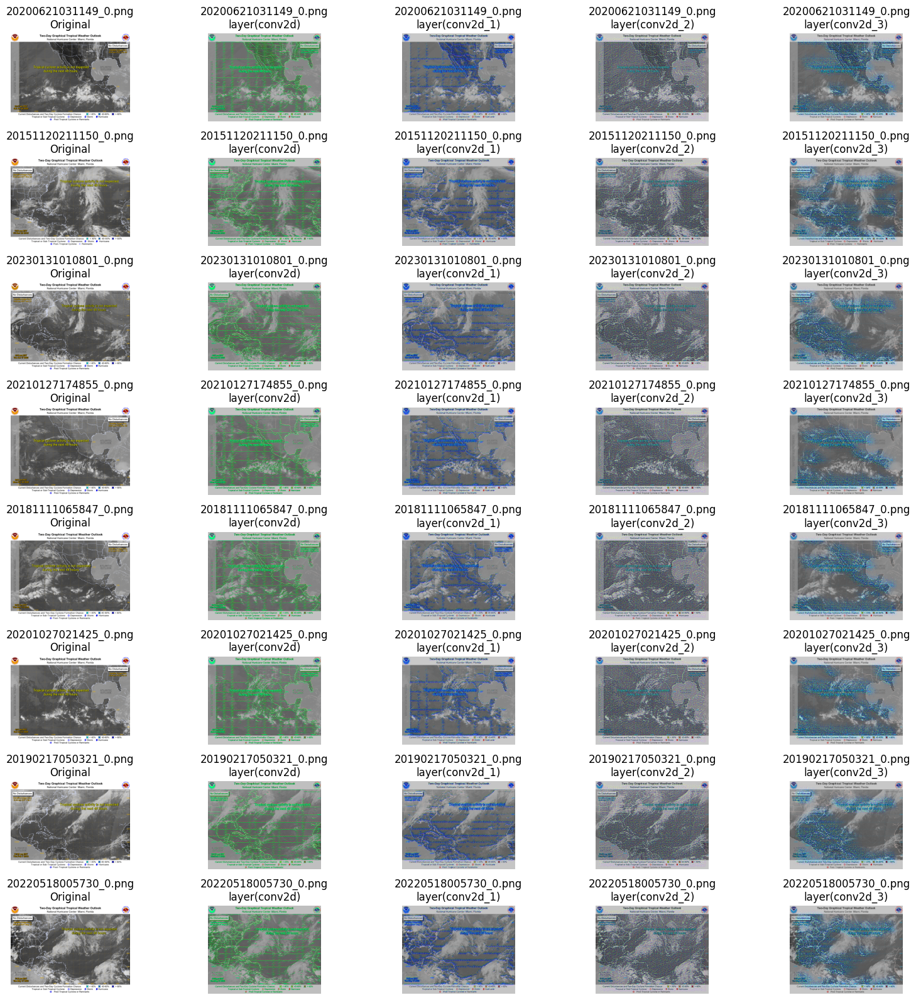

In [24]:
plot_random_images(random_calm, 'Calm')

### Convolutions for `storm`

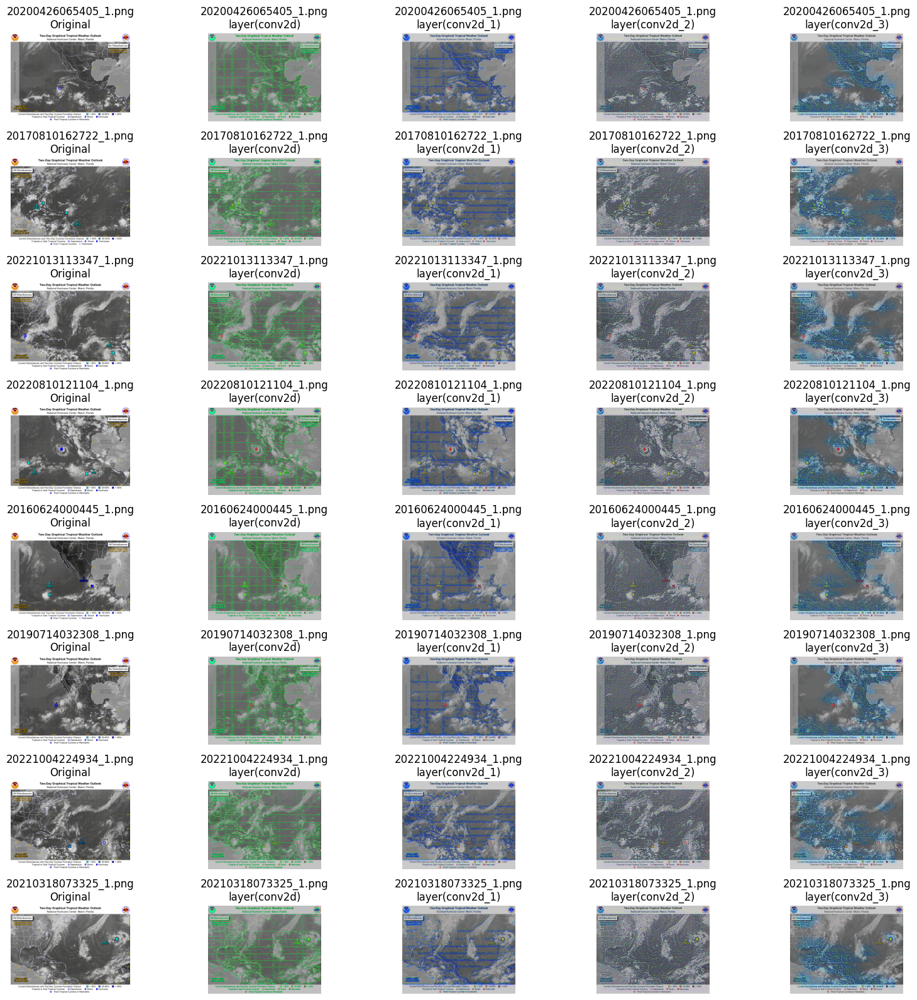

In [25]:
plot_random_images(random_storms, 'Storms')

## Image Augmentation
Do not use vertical or horizontal flip as storms in the northern hemisphere have a specific shape due to counterclockwise rotation.

In [26]:
dirs = [train_calm_dir, train_storm_dir]
for aDir in dirs:
    for train_image in glob.glob(f'{aDir}/*.png'):
        if '_rotation' in train_image:
            os.remove(train_image)
        if '_zoom' in train_image:
            os.remove(train_image)
        if '_width' in train_image:
            os.remove(train_image)             

#### Augmentation function

In [27]:
from PIL import Image as Image_PIL
def augment_images(category, base_name, aug_type, resized_img, img_array, datagen, title, show_result=True):
    if show_result:
        fig, axs = plt.subplots(2, 3, figsize=(10, 6))
        axs = axs.flatten()

        axs[0].imshow(resized_img)
        axs[0].set_title('Original Image')

        i = 1
        for batch in datagen.flow(img_array, batch_size=1):
            axs[i].imshow(batch[0]/255)
            axs[i].set_title(f'Iteration: {i}')

            augmented_image_pil = Image_PIL.fromarray((batch[0]).astype(np.uint8))
            augmented_image_pil = augmented_image_pil.resize((image_width, image_height))
            augmented_image_pil.save(f'{base_name}_{aug_type}_{i}.png')

            i += 1
            if i % 6 == 0:
                break

        plt.suptitle(f"{category} Image Augmentation ({title})", fontsize=16)
        plt.tight_layout()
        plt.show()
    
    else:
        i = 0
        for batch in datagen.flow(img_array, batch_size=1):
            i += 1
            augmented_image_pil = Image_PIL.fromarray((batch[0]).astype(np.uint8))
            augmented_image_pil.save(f'{base_name}_{aug_type}_{i}.png')
            if i % 5 == 0:
                break

def create_image_augmentation(target_dir, image_gen, title, aug_type, category):
    datagen = image_gen
    show_result = True

    for idx, train_image in enumerate(glob.glob(f'{target_dir}/*.png')):
        if '_' not in train_image: # Do not augment previously augmented image
            base_name = train_image.replace('.png', '')   

            img = cv2.imread(train_image)
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            resized_img = cv2.resize(img_rgb, (image_width, image_height))
            img_array = resized_img.reshape((1,) + resized_img.shape)

            if idx > 0:
                show_result = False
            augment_images(category, base_name, aug_type, resized_img, img_array, datagen, title, show_result)

### Rotation 45 degrees

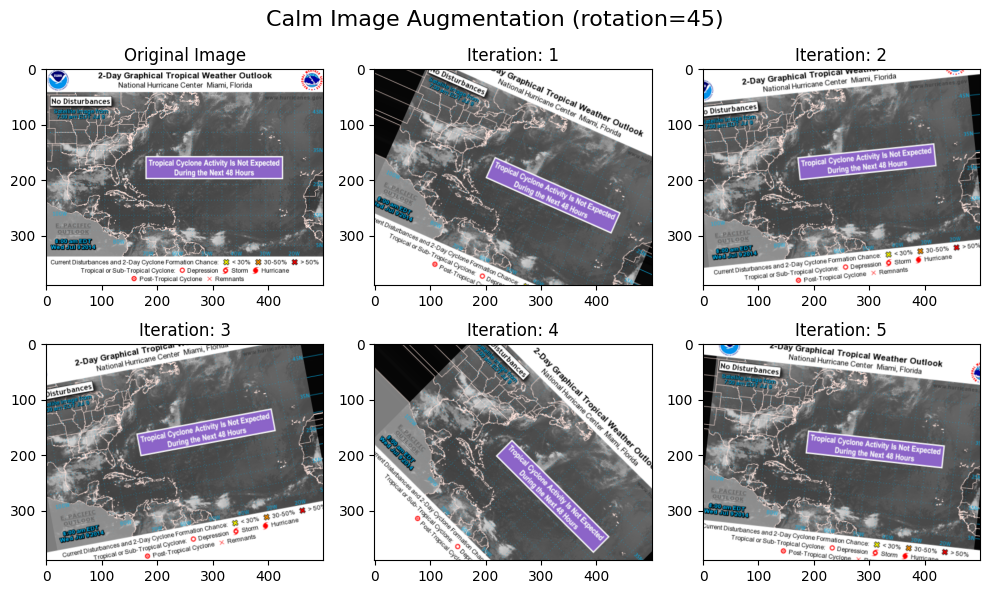

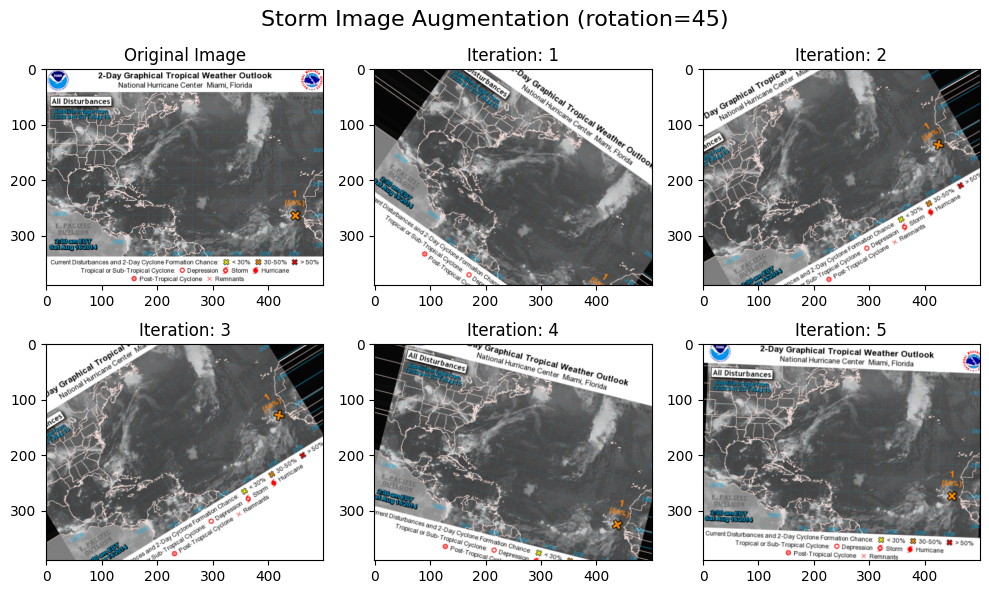

CPU times: total: 1min 3s
Wall time: 1min 44s


In [28]:
%%time
image_gen = ImageDataGenerator(rotation_range=45, fill_mode='nearest')
create_image_augmentation(train_calm_dir, image_gen, 'rotation=45', 'rotation', 'Calm')
create_image_augmentation(train_storm_dir, image_gen, 'rotation=45', 'rotation', 'Storm')

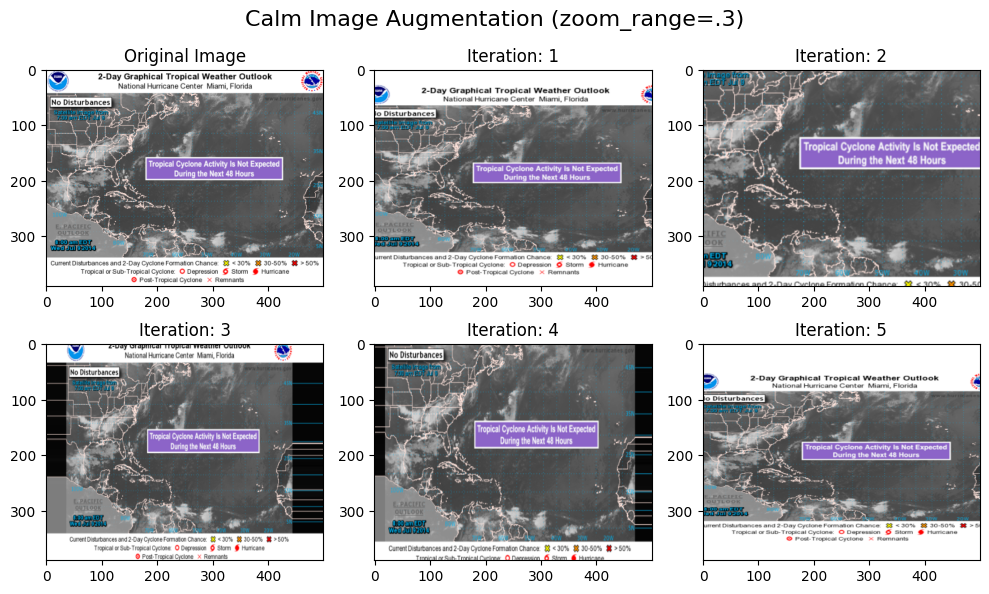

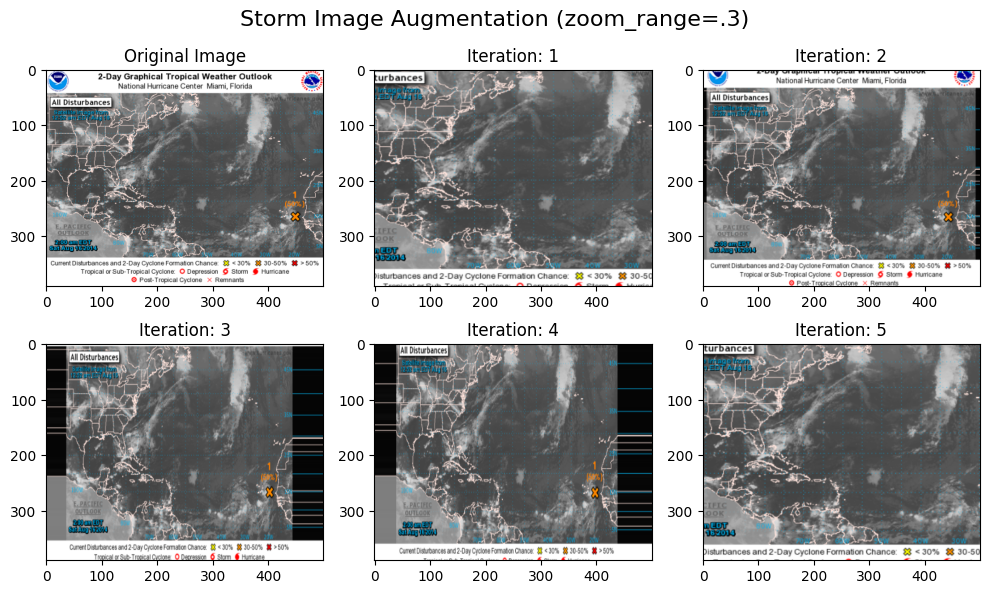

CPU times: total: 59.4 s
Wall time: 1min 43s


In [29]:
%%time
image_gen = ImageDataGenerator(zoom_range=.3, fill_mode='nearest')
create_image_augmentation(train_calm_dir, image_gen, 'zoom_range=.3', 'zoom', 'Calm')
create_image_augmentation(train_storm_dir, image_gen, 'zoom_range=.3', 'zoom', 'Storm')

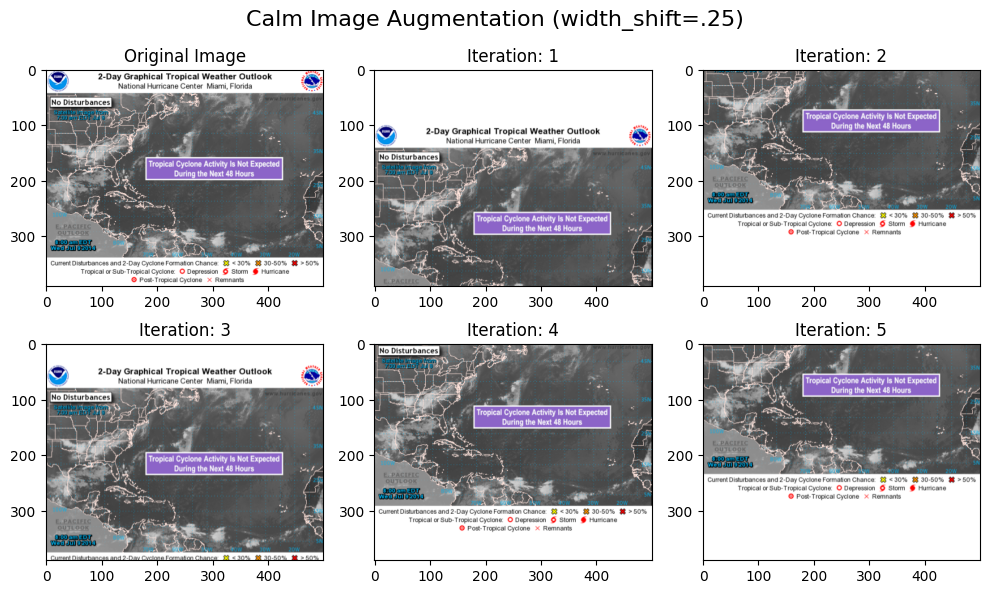

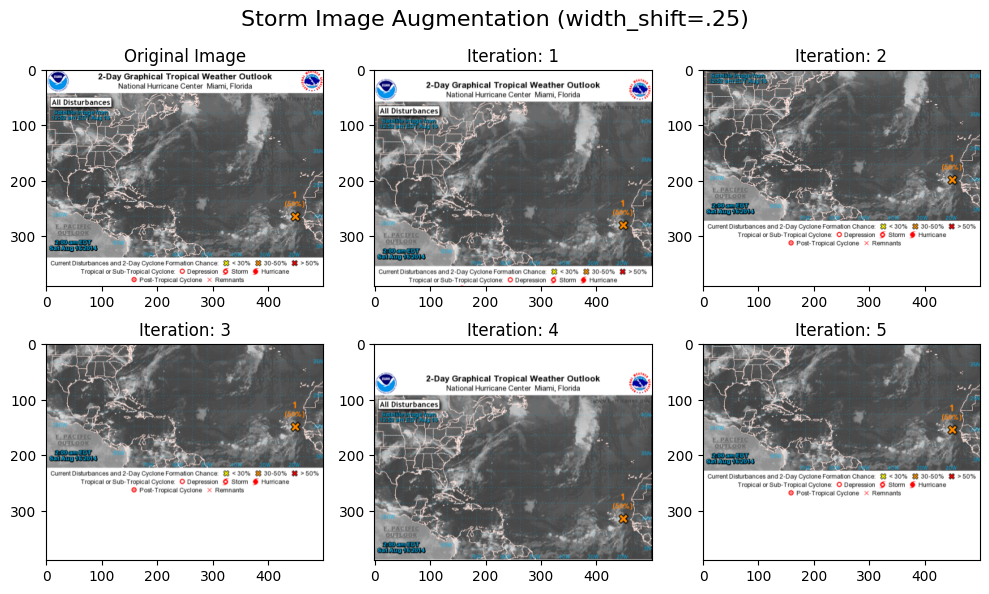

CPU times: total: 50.7 s
Wall time: 1min 40s


In [30]:
%%time
image_gen = ImageDataGenerator(width_shift_range=0.25, fill_mode='nearest')
create_image_augmentation(train_calm_dir, image_gen, 'width_shift=.25', 'width_shift', 'Calm')
create_image_augmentation(train_storm_dir, image_gen, 'width_shift=.25', 'width_shift', 'Storm')

### Rerun Model with Augmented Images

Model: "Base_Model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 388, 498, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 194, 249, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 192, 247, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 96, 123, 64)      0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 94, 121, 128)      73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 47, 60, 128)      0

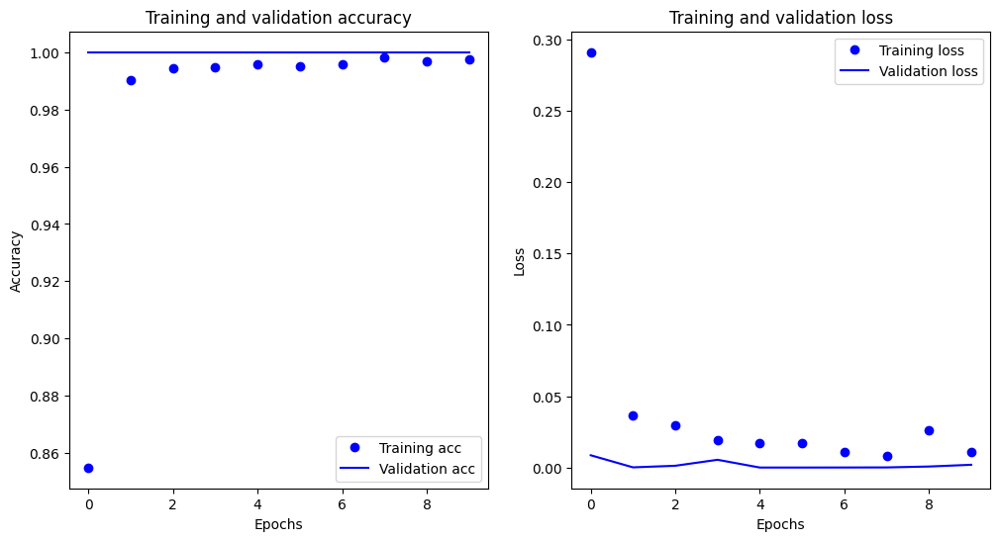

CPU times: total: 7min 16s
Wall time: 6min 26s


In [31]:
%%time
model = get_model()
train_generator, validation_generator = datagen_load_images()
history = fit_model(model, train_generator, validation_generator)
plot_history(history)

1/1 [==============================] - 0s 16ms/step


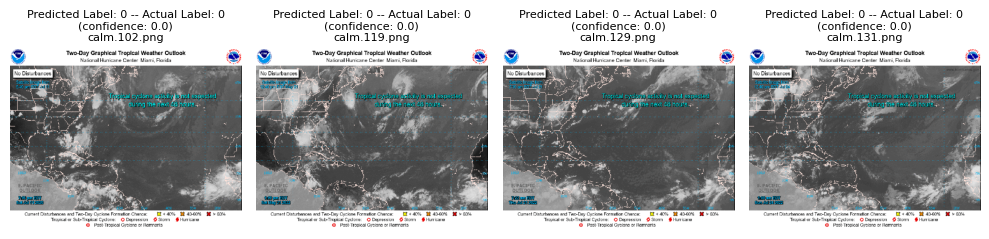

1/1 [==============================] - 0s 16ms/step


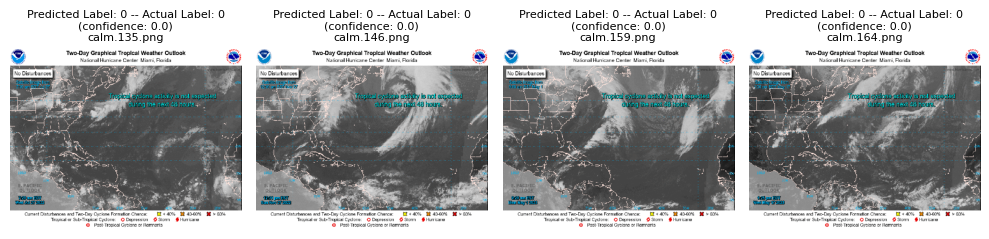

1/1 [==============================] - 0s 16ms/step


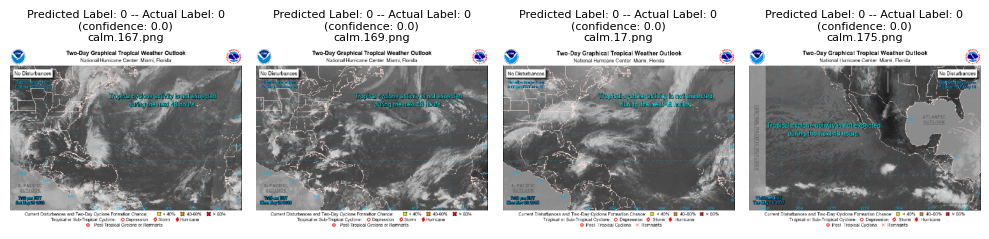

1/1 [==============================] - 0s 16ms/step


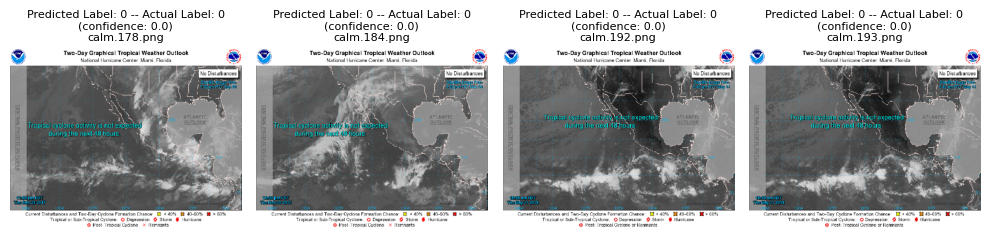

1/1 [==============================] - 0s 17ms/step


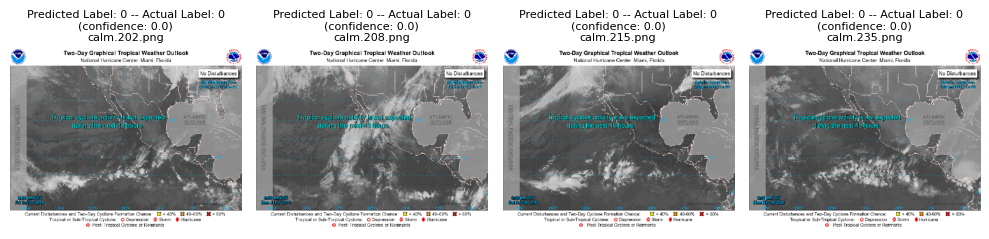

1/1 [==============================] - 0s 16ms/step


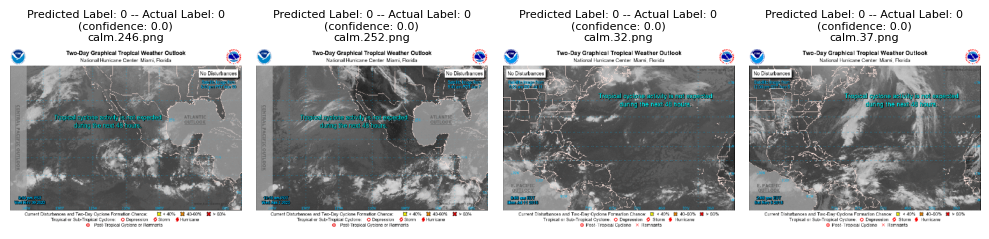

1/1 [==============================] - 0s 15ms/step


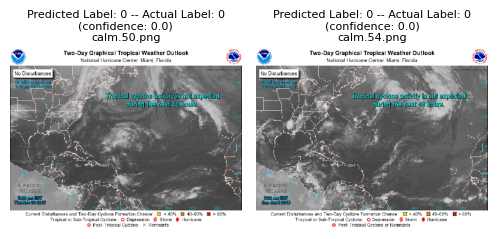

Accuracy: 100.0%


In [32]:
accuracy = convert_to_tensor_and_predict(model, test_calm_dir, '0')
print(f'Accuracy: {accuracy}%')

1/1 [==============================] - 0s 16ms/step


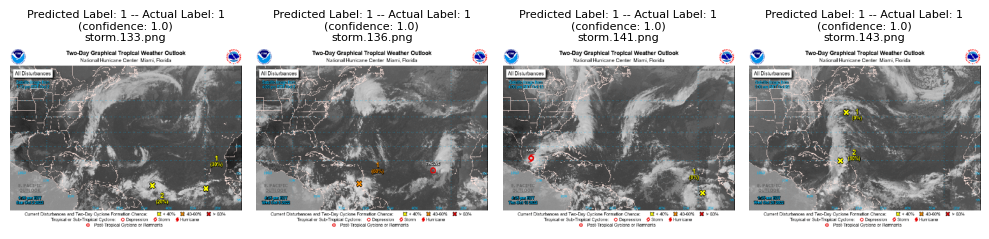

1/1 [==============================] - 0s 31ms/step


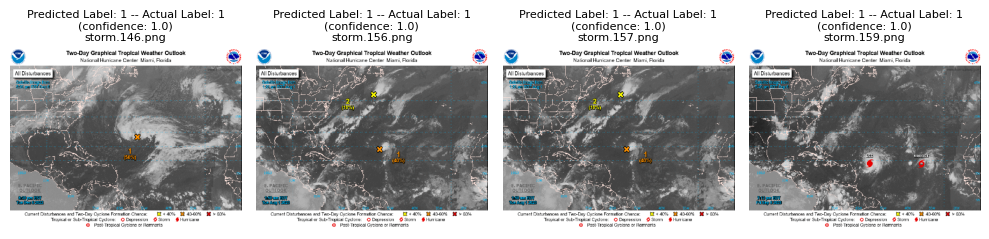

1/1 [==============================] - 0s 16ms/step


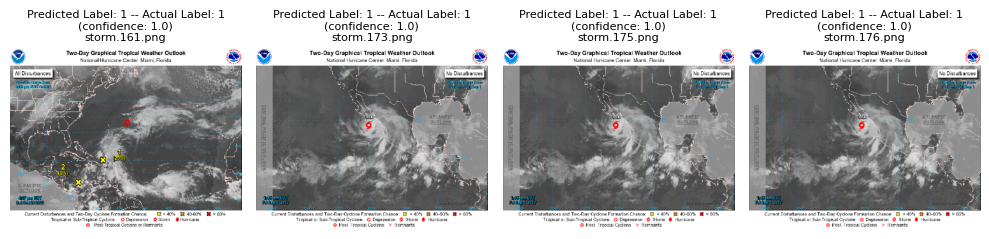

1/1 [==============================] - 0s 26ms/step


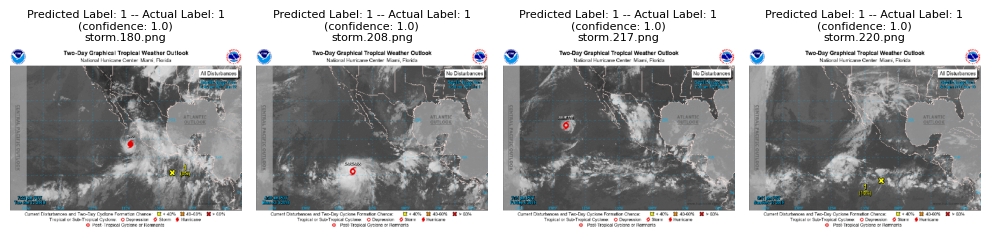

1/1 [==============================] - 0s 16ms/step


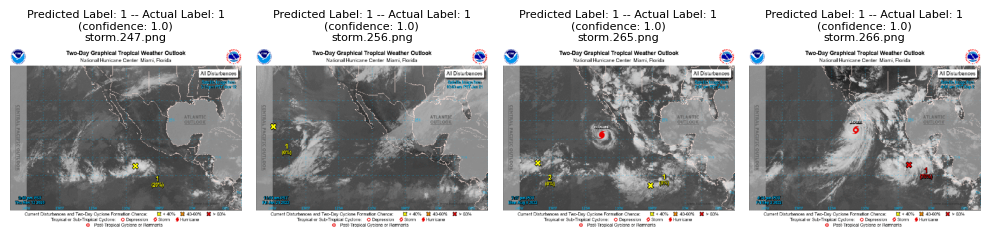

1/1 [==============================] - 0s 16ms/step


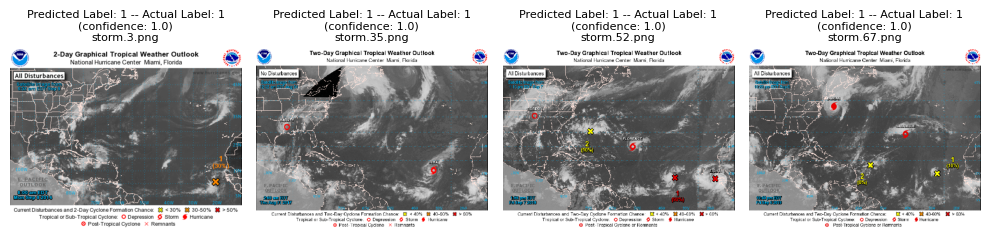

1/1 [==============================] - 0s 31ms/step


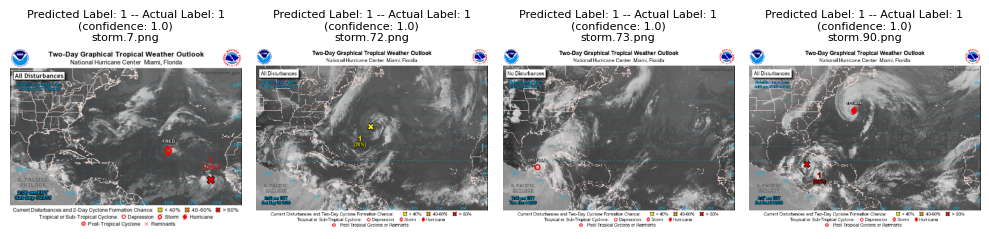

Accuracy: 100.0%


In [33]:
accuracy = convert_to_tensor_and_predict(model, test_storm_dir, '1')
print(f'Accuracy: {accuracy}%')